In [1]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [2]:
!pip install prophet plotly scikit-learn


In [17]:
import pandas as pd
import numpy as np

from sklearn.ensemble import IsolationForest

import plotly.express as px
import matplotlib.pyplot as plt



In [18]:
file_path = "/content/drive/MyDrive/FitPulse/cleaned_dataset.csv"
df = pd.read_csv(file_path)

df.head()


,Id,timestamp,heart_rate,steps,sleep_hours,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8
0,2022484408,2016-04-12 07:21:00+00:00,93,0,1.0,NaN,NaN,NaN,NaN
1,2022484408,2016-04-12 07:22:00+00:00,91,0,1.0,NaN,NaN,NaN,NaN
2,2022484408,2016-04-12 07:23:00+00:00,96,0,1.0,NaN,NaN,NaN,NaN
3,2022484408,2016-04-12 07:24:00+00:00,98,0,1.0,NaN,NaN,NaN,NaN
4,2022484408,2016-04-12 07:25:00+00:00,100,0,1.0,NaN,NaN,NaN,NaN


In [19]:
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284684 entries, 0 to 284683
Data columns (total 9 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   Id           284684 non-null  int64  
 1   timestamp    284684 non-null  object 
 2   heart_rate   284684 non-null  int64  
 3   steps        284684 non-null  int64  
 4   sleep_hours  198559 non-null  float64
 5   Unnamed: 5   0 non-null       float64
 6   Unnamed: 6   0 non-null       float64
 7   Unnamed: 7   0 non-null       float64
 8   Unnamed: 8   0 non-null       float64
dtypes: float64(5), int64(3), object(1)
memory usage: 19.5+ MB


In [20]:
heart_rate = df[['timestamp', 'heart_rate']].dropna()

heart_rate['ds'] = pd.to_datetime(heart_rate['timestamp']).dt.tz_localize(None)
heart_rate['y'] = heart_rate['heart_rate']

heart_rate = heart_rate[['ds', 'y']]
heart_rate.head()


,ds,y
0,2016-04-12 07:21:00,93
1,2016-04-12 07:22:00,91
2,2016-04-12 07:23:00,96
3,2016-04-12 07:24:00,98
4,2016-04-12 07:25:00,100


In [21]:
heart_rate['yhat'] = heart_rate['y'].rolling(
    window=10,
    center=True
).mean()

heart_rate.dropna(inplace=True)
heart_rate.head()


,ds,y,yhat
5,2016-04-12 07:26:00,101,99.6
6,2016-04-12 07:27:00,104,101.2
7,2016-04-12 07:28:00,105,103.3
8,2016-04-12 07:29:00,102,104.8
9,2016-04-12 07:30:00,106,105.9


In [22]:
heart_rate['residual'] = abs(heart_rate['y'] - heart_rate['yhat'])

threshold = heart_rate['residual'].mean() + 2 * heart_rate['residual'].std()

heart_rate['anomaly'] = heart_rate['residual'] > threshold
heart_rate['label'] = heart_rate['anomaly'].map(
    {True: 'Anomalous', False: 'Normal'}
)

heart_rate.head()


,ds,y,yhat,residual,anomaly,label
5,2016-04-12 07:26:00,101,99.6,1.4,False,Normal
6,2016-04-12 07:27:00,104,101.2,2.8,False,Normal
7,2016-04-12 07:28:00,105,103.3,1.7,False,Normal
8,2016-04-12 07:29:00,102,104.8,2.8,False,Normal
9,2016-04-12 07:30:00,106,105.9,0.1,False,Normal


In [24]:
fig = px.line(
    heart_rate,
    x='ds',
    y='y',
    title='Heart Rate Time-Series with Anomalies'
)

fig.add_scatter(
    x=heart_rate[heart_rate['anomaly']]['ds'],
    y=heart_rate[heart_rate['anomaly']]['y'],
    mode='markers',
    marker=dict(color='violet', size=8),
    name='Anomaly'
)

fig.show()


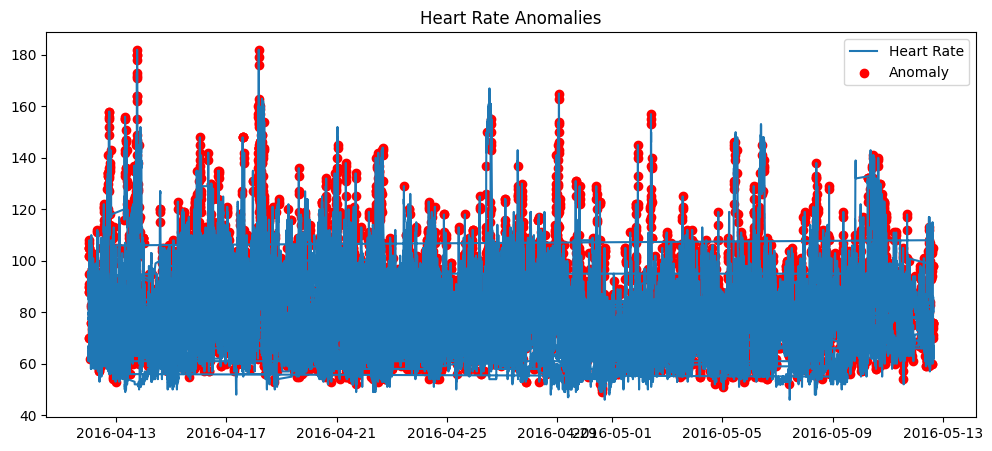

In [25]:
plt.figure(figsize=(12,5))
plt.plot(heart_rate['ds'], heart_rate['y'], label='Heart Rate')

plt.scatter(
    heart_rate[heart_rate['anomaly']]['ds'],
    heart_rate[heart_rate['anomaly']]['y'],
    color='red',
    label='Anomaly'
)

plt.title("Heart Rate Anomalies")
plt.legend()
plt.savefig("/content/drive/MyDrive/FitPulse/heart_rate_anomalies.png")
plt.show()


In [26]:
sleep = df[['timestamp', 'sleep_hours']].dropna()
sleep['date'] = pd.to_datetime(sleep['timestamp']).dt.date

sleep.head()


,timestamp,sleep_hours,date
0,2016-04-12 07:21:00+00:00,1.0,2016-04-12
1,2016-04-12 07:22:00+00:00,1.0,2016-04-12
2,2016-04-12 07:23:00+00:00,1.0,2016-04-12
3,2016-04-12 07:24:00+00:00,1.0,2016-04-12
4,2016-04-12 07:25:00+00:00,1.0,2016-04-12


In [27]:
sleep['anomaly'] = (sleep['sleep_hours'] < 4) | (sleep['sleep_hours'] > 10)
sleep['label'] = sleep['anomaly'].map(
    {True: 'Anomalous', False: 'Normal'}
)

sleep.head()


,timestamp,sleep_hours,date,anomaly,label
0,2016-04-12 07:21:00+00:00,1.0,2016-04-12,True,Anomalous
1,2016-04-12 07:22:00+00:00,1.0,2016-04-12,True,Anomalous
2,2016-04-12 07:23:00+00:00,1.0,2016-04-12,True,Anomalous
3,2016-04-12 07:24:00+00:00,1.0,2016-04-12,True,Anomalous
4,2016-04-12 07:25:00+00:00,1.0,2016-04-12,True,Anomalous


In [28]:
fig = px.bar(
    sleep,
    x='date',
    y='sleep_hours',
    color='anomaly',
    title='Sleep Pattern Anomalies'
)

fig.show()


/tmp/ipython-input-2689547714.py:13: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.

/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



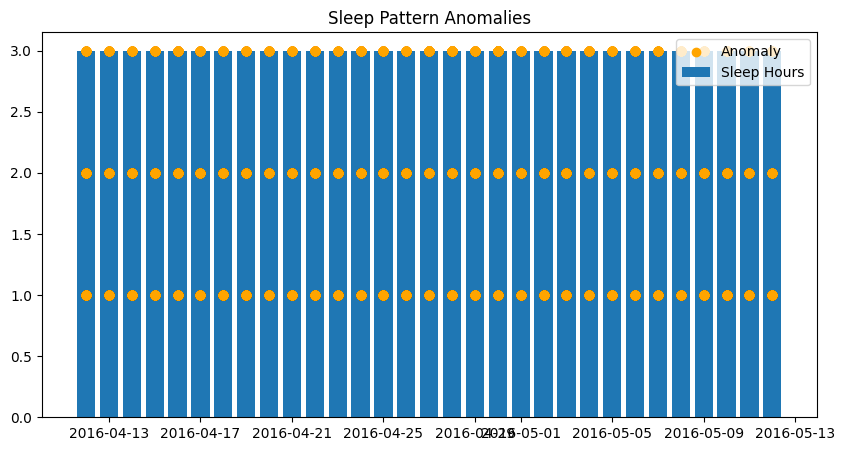

In [29]:
plt.figure(figsize=(10,5))
plt.bar(sleep['date'], sleep['sleep_hours'], label='Sleep Hours')

plt.scatter(
    sleep[sleep['anomaly']]['date'],
    sleep[sleep['anomaly']]['sleep_hours'],
    color='orange',
    label='Anomaly'
)

plt.title("Sleep Pattern Anomalies")
plt.legend()
plt.savefig("/content/drive/MyDrive/FitPulse/sleep_anomalies.png")
plt.show()


In [30]:
steps = df[['timestamp', 'steps']].dropna()
steps['date'] = pd.to_datetime(steps['timestamp'])

steps.head()


,timestamp,steps,date
0,2016-04-12 07:21:00+00:00,0,2016-04-12 07:21:00+00:00
1,2016-04-12 07:22:00+00:00,0,2016-04-12 07:22:00+00:00
2,2016-04-12 07:23:00+00:00,0,2016-04-12 07:23:00+00:00
3,2016-04-12 07:24:00+00:00,0,2016-04-12 07:24:00+00:00
4,2016-04-12 07:25:00+00:00,0,2016-04-12 07:25:00+00:00


In [31]:
iso_model = IsolationForest(
    contamination=0.05,
    random_state=42
)

steps['anomaly'] = iso_model.fit_predict(
    steps[['steps']]
) == -1

steps['label'] = steps['anomaly'].map(
    {True: 'Anomalous', False: 'Normal'}
)

steps.head()


,timestamp,steps,date,anomaly,label
0,2016-04-12 07:21:00+00:00,0,2016-04-12 07:21:00+00:00,False,Normal
1,2016-04-12 07:22:00+00:00,0,2016-04-12 07:22:00+00:00,False,Normal
2,2016-04-12 07:23:00+00:00,0,2016-04-12 07:23:00+00:00,False,Normal
3,2016-04-12 07:24:00+00:00,0,2016-04-12 07:24:00+00:00,False,Normal
4,2016-04-12 07:25:00+00:00,0,2016-04-12 07:25:00+00:00,False,Normal


In [32]:
fig = px.line(
    steps,
    x='date',
    y='steps',
    title='Step Count Trend with Alerts'
)

fig.add_scatter(
    x=steps[steps['anomaly']]['date'],
    y=steps[steps['anomaly']]['steps'],
    mode='markers',
    marker=dict(color='red', size=9),
    name='Anomaly'
)

fig.show()


In [33]:
heart_rate.to_csv("/content/drive/MyDrive/FitPulse/heart_rate_labeled.csv", index=False)
sleep.to_csv("/content/drive/MyDrive/FitPulse/sleep_labeled.csv", index=False)
steps.to_csv("/content/drive/MyDrive/FitPulse/steps_labeled.csv", index=False)
